The goal here is to train ONE RBM, then I will use similar code to do hyperparametric search.

In [264]:
# Activate project
using Pkg
Pkg.activate("/Users/alessiogiorlandino/Desktop/SAM/Project.toml")
Base.active_project()
# Resolve dependencies
Pkg.resolve()

  Activating project at `~/Desktop/SAM`


  No Changes to `~/Desktop/SAM/Project.toml`
  No Changes to `~/Desktop/SAM/Manifest.toml`


In [265]:
import Rfam, Infernal, Logomaker, FASTX
using Optimisers: Adam
using EllipsisNotation: (..)
using FillArrays: Falses
import Makie, CairoMakie
using Makie: @colorant_str
import SamApp
using LinearAlgebra
using Statistics

using DelimitedFiles: readdlm

In [266]:
using BioSequences: LongRNA, @rna_str
using Statistics: mean, std, cor
import JLD2

import RestrictedBoltzmannMachines as RBMs
import CudaRBMs, CenteredRBMs
using CudaRBMs: gpu, cpu
using CenteredRBMs: CenteredRBM, center, uncenter, center_from_data!
using RestrictedBoltzmannMachines: initialize!, RBM, xReLU, Potts, pcd!, Binary, log_pseudolikelihood, free_energy
using RBMsAnnealedImportanceSampling: aise, raise, logmeanexp, logstdexp, logvarexp

using MiniLoggers: global_logger, MiniLogger
global_logger(MiniLogger());

# Load sequence data from Rfam

In [267]:
cm = Infernal.cmfetch(Rfam.cm(), "RF00162")
natural_seed_stk = Infernal.esl_afetch(Rfam.seed(), "RF00162");
natural_seed_afa = Infernal.esl_reformat("afa", natural_seed_stk.out);
natural_seed_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_seed_afa.out)));

# Consensus secondary structure in WUSS format
seed_wuss = SamApp.stockholm_ss(natural_seed_stk.out)
seed_match_positions = findall(c -> c ≠ '.' && c ≠ '~', seed_wuss);

natural_hits_afa = Infernal.cmalign(Infernal.cmfetch(Rfam.cm(), "RF00162").out, Rfam.fasta_file("RF00162"); outformat="afa");
natural_hits_ids = FASTX.identifier.(FASTX.FASTA.Reader(open(natural_hits_afa.out)));

In [268]:
natural_seed_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_seed_afa.out))) do record
    FASTX.sequence(record)[seed_match_positions]
end

natural_hits_sequences_matchonly = map(FASTX.FASTA.Reader(open(natural_hits_afa.out))) do record
    filter(c -> !islowercase(c) && c ≠ '.', FASTX.sequence(record))
end

@assert only(unique(length.(natural_seed_sequences_matchonly))) == length(seed_match_positions) == 108
@assert only(unique(length.(natural_hits_sequences_matchonly))) == length(seed_match_positions) == 108

In [269]:
data_hits = SamApp.onehot(LongRNA{4}.(natural_hits_sequences_matchonly));
#when plottinf we'll use the phylum labels: 
label_file = open("labels.txt","r")
label =readdlm("labels.txt")


6112×1 Matrix{Any}:
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 "Bacillota"
 ⋮
 "other"
 "Bacteroidota"
 "Bacillota"
 "Bacteroidota"
 "Bacillota"
 "Bacteroidota"
 "Actinomycetota"
 "other"
 "other"

In [270]:
SamApp.seqlogo_entropic(reshape(mean(data_hits; dims=3), 5, 108)).fig

PythonCall.PyException: Python: UnicodeEncodeError: 'ascii' codec can't encode character '\u229f' in position 21: ordinal not in range(128)

# PCA

In [271]:
function PCA(data)
    data_shape = size(data)
    cov_matrix = cov(data, dims=2)
    cov_eigenval = eigvals(cov_matrix)
    expl_ratio = cov_eigenval/sum(cov_eigenval)
    ort_trasf = eigvecs(cov_matrix)
    return transpose(ort_trasf)*data, expl_ratio
end
    


PCA (generic function with 3 methods)

In [272]:
data_shape = size(data_hits)
data_flatten = reshape(data_hits, (data_shape[1]*data_shape[2], data_shape[3]))

data_flatten_rot, expl_ratio = PCA(data_flatten)


([0.474904001412625 0.4749040014126248 … 0.4749040014126278 0.47490400141263467; -0.31295950608130696 -0.3129595060813052 … -0.3129595060813021 -0.3129595060812951; … ; -0.002506256511098176 0.6624870089304071 … -0.23221503180757558 -1.5631329559374116; 4.1319333247054795 3.772432339699068 … 1.621676915562134 1.799416255177813], [-8.970479039948518e-18, -7.362424520834739e-18, -6.735700208217175e-18, -5.978263083096702e-18, -5.4738926432970576e-18, -5.015299434785437e-18, -4.784325133202614e-18, -4.625979005137508e-18, -4.3651150855584474e-18, -4.2426615574146734e-18  …  0.016413208835863433, 0.017429863202782468, 0.0212129701406351, 0.023391155420478784, 0.025243487653912815, 0.027956916862654006, 0.02993200365680448, 0.04387393386481623, 0.045843645289221066, 0.0721349168048522])

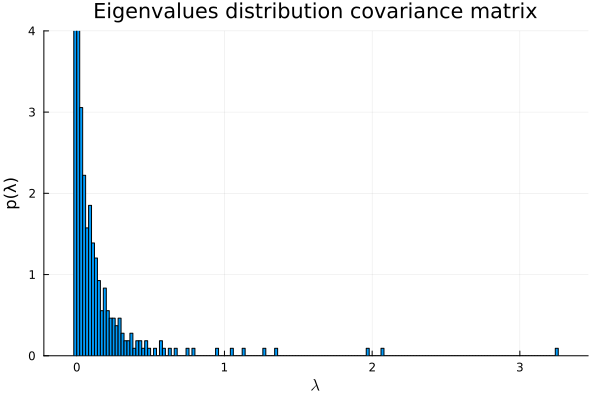

In [273]:
cov_eigenval = eigvals(cov(data_flatten, dims=2))
histogram(cov_eigenval, normalize=:pdf, ylim=(0,4), legend=false, title="Eigenvalues distribution covariance matrix")
xlabel!(L"λ")
ylabel!("p(λ)")

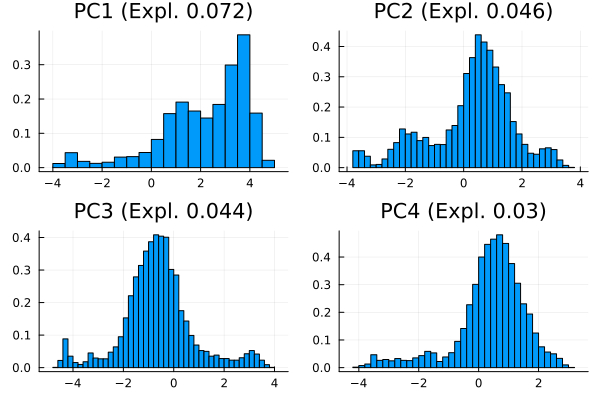

In [274]:
# First Component Histogram 
pc1 = data_flatten_rot[end, :]
p1=histogram(pc1, normalize=:pdf, title=("PC1 (Expl. $(round(expl_ratio[end], digits=3)))"))


pc2 = data_flatten_rot[end-1, :]
p2=histogram(pc2, normalize=:pdf, title=("PC2 (Expl. $(round(expl_ratio[end-1], digits=3)))"))

pc3 = data_flatten_rot[end-2, :]
p3=histogram(pc3, normalize=:pdf, title=("PC3 (Expl. $(round(expl_ratio[end-2], digits=3)))"))

pc4 = data_flatten_rot[end-3, :]
p4=histogram(pc4, normalize=:pdf, title=("PC4 (Expl. $(round(expl_ratio[end-3], digits=3)))"))


plot(p1, p2, p3, p4, layout=(2,2), legend=false)

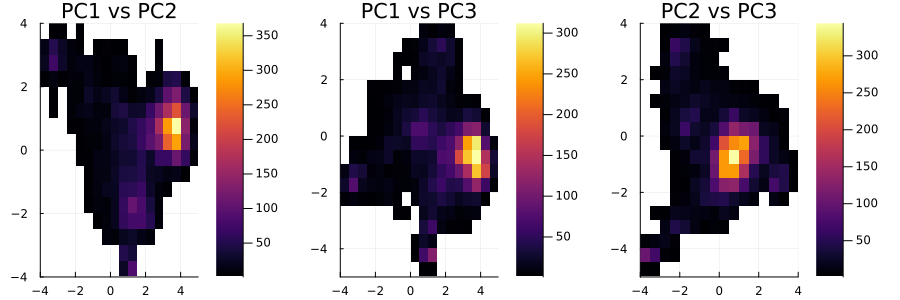

In [275]:
p1=histogram2d(pc1, pc2, title="PC1 vs PC2")
p2=histogram2d(pc1, pc3, title="PC1 vs PC3")
p3=histogram2d(pc2, pc3, title="PC2 vs PC3")

plot(p1, p2, p3, layout=(1,3), legend=false, size=(900,300))

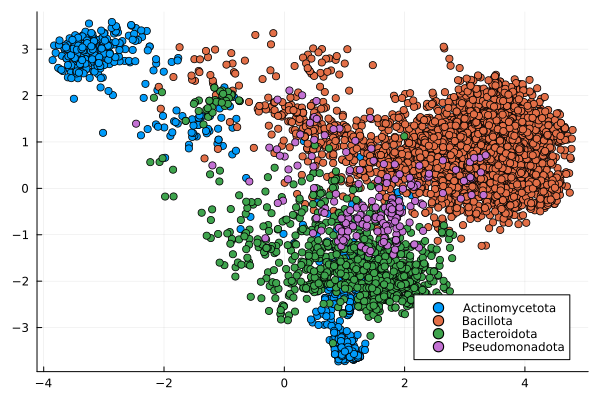

In [276]:
using DataFrames, StatsPlots
df_v = DataFrame(PC1=pc1, PC2=pc2, PC3=pc3, PC4=pc4, Label=label[:,]) 
# exclude "other" from plotting
filter!(row -> row.Label .!= "other", df_v)

scatter(df_v.PC1 , df_v.PC2, group=df_v.Label)


# Train RBM

## Bottom RBM

In [277]:
# Sparsity parameter, as defined in Tubiana, RM, 2017 PRL (denoted \hat{p} there)
# This is smaller for sparser weights
function sparsity(rbm)
    num = sum(rbm.w.^2, dims=1:ndims(rbm.visible)).^2
    den = sum(rbm.w.^4, dims=1:ndims(rbm.visible))
    return sum(num ./ den) / length(rbm.w)
end

sparsity (generic function with 1 method)

In [316]:
function callback(; rbm, iter, kw...)
    if iszero(iter % 100)
        Δt = @elapsed (lpl = mean(log_pseudolikelihood(rbm, data)))
        @info iter lpl Δt
        write(logfile, "$iter $lpl \n")
    end

end

callback (generic function with 1 method)

[2023-04-22 22:44:27] Info: 100 lpl = -0.6219262623137682, Δt = 0.241550542


[2023-04-22 22:44:32] Info: 200 lpl = -0.5613749973958305, Δt = 0.2744815


[2023-04-22 22:44:38] Info: 300 lpl = -0.5305145764409854, Δt = 0.272344666


[2023-04-22 22:44:44] Info: 400 lpl = -0.5195551463585742, Δt = 0.245909125


[2023-04-22 22:44:50] Info: 500 lpl = -0.4905147008270693, Δt = 0.238651208


[2023-04-22 22:44:55] Info: 600 lpl = -0.4723868377181615, Δt = 0.264446959


[2023-04-22 22:45:00] Info: 700 lpl = -0.47399736519681945, Δt = 0.257333833


[2023-04-22 22:45:06] Info: 800 lpl = -0.464018206329046, Δt = 0.265268417


[2023-04-22 22:45:11] Info: 900 lpl = -0.4518806015961673, Δt = 0.284737542


[2023-04-22 22:45:16] Info: 1000 lpl = -0.4221462409549524, Δt = 0.277359333


[2023-04-22 22:45:22] Info: 1100 lpl = -0.4313546523999995, Δt = 0.267722083


[2023-04-22 22:45:27] Info: 1200 lpl = -0.42288951498110866, Δt = 0.267293375


[2023-04-22 22:45:33] Info: 1300 lpl = -0.413112765929234, Δt = 0.280262208


[2023-04-22 22:45:38] Info: 1400 lpl = -0.40878853863529485, Δt = 0.275565792


[2023-04-22 22:45:43] Info: 1500 lpl = -0.4035270169609571, Δt = 0.276643958


[2023-04-22 22:45:49] Info: 1600 lpl = -0.3863491487645024, Δt = 0.277978833


[2023-04-22 22:45:54] Info: 1700 lpl = -0.4015727926879943, Δt = 0.259857084


[2023-04-22 22:45:59] Info: 1800 lpl = -0.39766970054942846, Δt = 0.259417083


[2023-04-22 22:46:04] Info: 1900 lpl = -0.3802493668203186, Δt = 0.268357292


[2023-04-22 22:46:10] Info: 2000 lpl = -0.37952768808345333, Δt = 0.273909709


[2023-04-22 22:46:15] Info: 2100 lpl = -0.3933166262105516, Δt = 0.290686292


[2023-04-22 22:46:21] Info: 2200 lpl = -0.38387651370190345, Δt = 0.290880625


[2023-04-22 22:46:27] Info: 2300 lpl = -0.3715718452927123, Δt = 0.275650708


[2023-04-22 22:46:32] Info: 2400 lpl = -0.3775813056918678, Δt = 0.298457167


[2023-04-22 22:46:38] Info: 2500 lpl = -0.37062320200241455, Δt = 0.281797417


[2023-04-22 22:46:43] Info: 2600 lpl = -0.36147741709704284, Δt = 0.261676083


[2023-04-22 22:46:49] Info: 2700 lpl = -0.37195676909267295, Δt = 0.261001708


[2023-04-22 22:46:55] Info: 2800 lpl = -0.3586920423429485, Δt = 0.389431


[2023-04-22 22:47:01] Info: 2900 lpl = -0.3698715085037435, Δt = 0.332894292


[2023-04-22 22:47:07] Info: 3000 lpl = -0.3481056926209823, Δt = 0.260843458


[2023-04-22 22:47:12] Info: 3100 lpl = -0.34321911232334457, Δt = 0.275857208


[2023-04-22 22:47:18] Info: 3200 lpl = -0.34925018852588047, Δt = 0.292050709


[2023-04-22 22:47:23] Info: 3300 lpl = -0.3406869617884174, Δt = 0.25708475


[2023-04-22 22:47:29] Info: 3400 lpl = -0.3291339100485035, Δt = 0.422589666


[2023-04-22 22:47:34] Info: 3500 lpl = -0.35385015272361653, Δt = 0.266840959


[2023-04-22 22:47:40] Info: 3600 lpl = -0.34478779418403904, Δt = 0.273216292


[2023-04-22 22:47:46] Info: 3700 lpl = -0.3450869044395546, Δt = 0.295971958


[2023-04-22 22:47:51] Info: 3800 lpl = -0.3547838531285197, Δt = 0.265209541


[2023-04-22 22:47:56] Info: 3900 lpl = -0.3264526564123895, Δt = 0.267220625


[2023-04-22 22:48:01] Info: 4000 lpl = -0.32076526685556467, Δt = 0.269429417


[2023-04-22 22:48:06] Info: 4100 lpl = -0.33010304437590005, Δt = 0.280450084


[2023-04-22 22:48:13] Info: 4200 lpl = -0.3273126395393447, Δt = 0.271812125


[2023-04-22 22:48:18] Info: 4300 lpl = -0.33171553816306243, Δt = 0.289244708


[2023-04-22 22:48:23] Info: 4400 lpl = -0.3241310743292408, Δt = 0.262393541


[2023-04-22 22:48:28] Info: 4500 lpl = -0.32588398831218335, Δt = 0.258628167


[2023-04-22 22:48:33] Info: 4600 lpl = -0.33032801574534815, Δt = 0.31187325


[2023-04-22 22:48:38] Info: 4700 lpl = -0.32212815077414525, Δt = 0.265930167


[2023-04-22 22:48:44] Info: 4800 lpl = -0.32233843287585373, Δt = 0.291542042


[2023-04-22 22:48:49] Info: 4900 lpl = -0.3313019245954478, Δt = 0.267083583


[2023-04-22 22:48:54] Info: 5000 lpl = -0.32382982137616617, Δt = 0.265718791


[2023-04-22 22:48:59] Info: 5100 lpl = -0.3156599451826594, Δt = 0.278676041


[2023-04-22 22:49:04] Info: 5200 lpl = -0.3275234679193478, Δt = 0.278873834


[2023-04-22 22:49:09] Info: 5300 lpl = -0.3258035378238573, Δt = 0.264479417


[2023-04-22 22:49:14] Info: 5400 lpl = -0.3156859409438394, Δt = 0.270177542


[2023-04-22 22:49:19] Info: 5500 lpl = -0.30602095739121543, Δt = 0.270115666


[2023-04-22 22:49:24] Info: 5600 lpl = -0.31956895567253407, Δt = 0.268330125


[2023-04-22 22:49:29] Info: 5700 lpl = -0.3156503774047868, Δt = 0.268288208


[2023-04-22 22:49:34] Info: 5800 lpl = -0.33180251555585066, Δt = 0.265993375


[2023-04-22 22:49:39] Info: 5900 lpl = -0.3064577443558337, Δt = 0.275786084


[2023-04-22 22:49:44] Info: 6000 lpl = -0.298504348402063, Δt = 0.263493375


[2023-04-22 22:49:49] Info: 6100 lpl = -0.30633423352175343, Δt = 0.263317709


[2023-04-22 22:49:54] Info: 6200 lpl = -0.3014057299085334, Δt = 0.281718167


[2023-04-22 22:49:59] Info: 6300 lpl = -0.3144793412474638, Δt = 0.26739875


[2023-04-22 22:50:04] Info: 6400 lpl = -0.3099230297674816, Δt = 0.312665167


[2023-04-22 22:50:09] Info: 6500 lpl = -0.31526693499552894, Δt = 0.270127125


[2023-04-22 22:50:14] Info: 6600 lpl = -0.30262523921025275, Δt = 0.277796042


[2023-04-22 22:50:19] Info: 6700 lpl = -0.2977223632955225, Δt = 0.270147292


[2023-04-22 22:50:24] Info: 6800 lpl = -0.2955995597742391, Δt = 0.27490875


[2023-04-22 22:50:29] Info: 6900 lpl = -0.3031713560950108, Δt = 0.273452125


[2023-04-22 22:50:34] Info: 7000 lpl = -0.29840315366251646, Δt = 0.273523875


[2023-04-22 22:50:39] Info: 7100 lpl = -0.2997872682030958, Δt = 0.281993292


[2023-04-22 22:50:44] Info: 7200 lpl = -0.28587720424068724, Δt = 0.281011792


[2023-04-22 22:50:49] Info: 7300 lpl = -0.3005979539826622, Δt = 0.283143416


[2023-04-22 22:50:54] Info: 7400 lpl = -0.29842317552035197, Δt = 0.285182375


[2023-04-22 22:50:59] Info: 7500 lpl = -0.29126829698041623, Δt = 0.286812125


[2023-04-22 22:51:04] Info: 7600 lpl = -0.29527847935614715, Δt = 0.276292292


[2023-04-22 22:51:09] Info: 7700 lpl = -0.28454495228635573, Δt = 0.291399959


[2023-04-22 22:51:14] Info: 7800 lpl = -0.30895059294256044, Δt = 0.27431


[2023-04-22 22:51:19] Info: 7900 lpl = -0.2924603357868605, Δt = 0.278517625


[2023-04-22 22:51:24] Info: 8000 lpl = -0.28747400521586974, Δt = 0.267081041


[2023-04-22 22:51:29] Info: 8100 lpl = -0.29941415102885083, Δt = 0.2763755


[2023-04-22 22:51:34] Info: 8200 lpl = -0.3047788951034603, Δt = 0.286894209


[2023-04-22 22:51:39] Info: 8300 lpl = -0.2922336652527159, Δt = 0.275678


[2023-04-22 22:51:44] Info: 8400 lpl = -0.29480246025999707, Δt = 0.294690458


[2023-04-22 22:51:49] Info: 8500 lpl = -0.2860467321128888, Δt = 0.269179375


[2023-04-22 22:51:54] Info: 8600 lpl = -0.28130342449967033, Δt = 0.288585333


[2023-04-22 22:51:58] Info: 8700 lpl = -0.2864003541513167, Δt = 0.280672916


[2023-04-22 22:52:03] Info: 8800 lpl = -0.28439329209470415, Δt = 0.282914208


[2023-04-22 22:52:08] Info: 8900 lpl = -0.2794049687719147, Δt = 0.281001291


[2023-04-22 22:52:13] Info: 9000 lpl = -0.28319906580842497, Δt = 0.273726917


[2023-04-22 22:52:18] Info: 9100 lpl = -0.2798862929694644, Δt = 0.288390375


[2023-04-22 22:52:24] Info: 9200 lpl = -0.28342579658660894, Δt = 0.297891833


[2023-04-22 22:52:29] Info: 9300 lpl = -0.27942692306895545, Δt = 0.299089416


[2023-04-22 22:52:34] Info: 9400 lpl = -0.29783156205947164, Δt = 0.291001917


[2023-04-22 22:52:39] Info: 9500 lpl = -0.28523763266041213, Δt = 0.280892084


[2023-04-22 22:52:44] Info: 9600 lpl = -0.280679003263572, Δt = 0.292287792


[2023-04-22 22:52:50] Info: 9700 lpl = -0.2871146649299457, Δt = 0.344280667


[2023-04-22 22:52:56] Info: 9800 lpl = -0.28544989934514353, Δt = 0.343239458


[2023-04-22 22:53:03] Info: 9900 lpl = -0.28238141585158855, Δt = 0.307626292


[2023-04-22 22:53:10] Info: 10000 lpl = -0.28247129606885246, Δt = 0.320225292


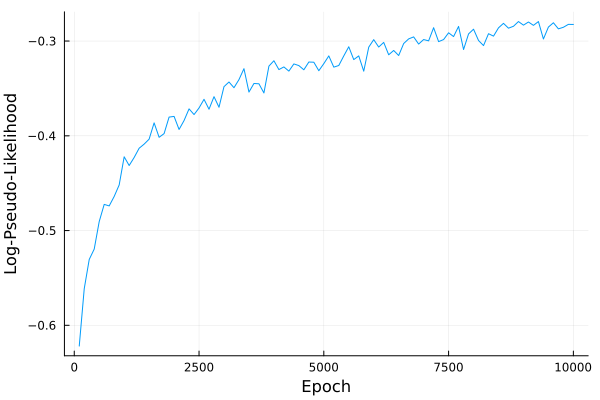

In [304]:
logfile = open("./Log/Stacked1.txt", "w+")


data = data_hits;
n_hidden1 = 256
rbm1 = center(RBM(Potts((5, 108)), Binary((n_hidden1,)), zeros(5, 108, n_hidden1)));
initialize!(rbm1, data);
pcd!(
    rbm1, data; 
    batchsize=256, iters=10000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=data[.., rand(1:size(data)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked1.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

## Second RBM


[2023-04-22 23:19:58] Info: 100 lpl = -0.5961877443580924, Δt = 0.029631125


[2023-04-22 23:20:00] Info: 200 lpl = -0.5656978223999407, Δt = 0.030037791


[2023-04-22 23:20:02] Info: 300 lpl = -0.5431513431983006, Δt = 0.0368315


[2023-04-22 23:20:05] Info: 400 lpl = -0.5329351213420513, Δt = 0.032257458


[2023-04-22 23:20:07] Info: 500 lpl = -0.520815260038993, Δt = 0.033756708


[2023-04-22 23:20:09] Info: 600 lpl = -0.5054596064908111, Δt = 0.035290083


[2023-04-22 23:20:11] Info: 700 lpl = -0.5015815862182617, Δt = 0.035148791


[2023-04-22 23:20:13] Info: 800 lpl = -0.5029328379085238, Δt = 0.035580167


[2023-04-22 23:20:16] Info: 900 lpl = -0.4861837340988438, Δt = 0.03490075


[2023-04-22 23:20:18] Info: 1000 lpl = -0.4838373720027427, Δt = 0.036643416


[2023-04-22 23:20:20] Info: 1100 lpl = -0.48556776619108, Δt = 0.035875458


[2023-04-22 23:20:22] Info: 1200 lpl = -0.4776578454803816, Δt = 0.034591583


[2023-04-22 23:20:24] Info: 1300 lpl = -0.47315946154908867, Δt = 0.036919208


[2023-04-22 23:20:26] Info: 1400 lpl = -0.47806210399524507, Δt = 0.0368225


[2023-04-22 23:20:28] Info: 1500 lpl = -0.4630316887141377, Δt = 0.042950375


[2023-04-22 23:20:30] Info: 1600 lpl = -0.4704188797471696, Δt = 0.037081042


[2023-04-22 23:20:32] Info: 1700 lpl = -0.46535397338782963, Δt = 0.037274958


[2023-04-22 23:20:34] Info: 1800 lpl = -0.46142076917500674, Δt = 0.035946833


[2023-04-22 23:20:36] Info: 1900 lpl = -0.45654609237860666, Δt = 0.037004542


[2023-04-22 23:20:38] Info: 2000 lpl = -0.4623029932536962, Δt = 0.037891375


[2023-04-22 23:20:40] Info: 2100 lpl = -0.4578847176090274, Δt = 0.037051583


[2023-04-22 23:20:42] Info: 2200 lpl = -0.46329657586709755, Δt = 0.037209125


[2023-04-22 23:20:44] Info: 2300 lpl = -0.45758966504589893, Δt = 0.037919209


[2023-04-22 23:20:46] Info: 2400 lpl = -0.45163366520227854, Δt = 0.050663084


[2023-04-22 23:20:49] Info: 2500 lpl = -0.44673514628686944, Δt = 0.037399541


[2023-04-22 23:20:51] Info: 2600 lpl = -0.45519843663767817, Δt = 0.038862375


[2023-04-22 23:20:53] Info: 2700 lpl = -0.45631104899187797, Δt = 0.038948667


[2023-04-22 23:20:55] Info: 2800 lpl = -0.439786405670681, Δt = 0.039015125


[2023-04-22 23:20:57] Info: 2900 lpl = -0.4566341054161125, Δt = 0.039155917


[2023-04-22 23:20:59] Info: 3000 lpl = -0.45479431664307013, Δt = 0.049680125


[2023-04-22 23:21:01] Info: 3100 lpl = -0.4309908324788654, Δt = 0.038624292


[2023-04-22 23:21:03] Info: 3200 lpl = -0.4489701098933921, Δt = 0.039360666


[2023-04-22 23:21:05] Info: 3300 lpl = -0.4450143270123415, Δt = 0.03854175


[2023-04-22 23:21:08] Info: 3400 lpl = -0.44851672809321264, Δt = 0.040049583


[2023-04-22 23:21:10] Info: 3500 lpl = -0.456438098411085, Δt = 0.039504917


[2023-04-22 23:21:12] Info: 3600 lpl = -0.43714269111010545, Δt = 0.039712875


[2023-04-22 23:21:14] Info: 3700 lpl = -0.434303372245632, Δt = 0.038892416


[2023-04-22 23:21:16] Info: 3800 lpl = -0.441724224638747, Δt = 0.039943583


[2023-04-22 23:21:18] Info: 3900 lpl = -0.43640550485592633, Δt = 0.040068666


[2023-04-22 23:21:20] Info: 4000 lpl = -0.43092917706739564, Δt = 0.039505542


[2023-04-22 23:21:22] Info: 4100 lpl = -0.44206792150161794, Δt = 0.039629417


[2023-04-22 23:21:24] Info: 4200 lpl = -0.4418859658317927, Δt = 0.038939375


[2023-04-22 23:21:26] Info: 4300 lpl = -0.4367945756605552, Δt = 0.040349292


[2023-04-22 23:21:28] Info: 4400 lpl = -0.4366447611994307, Δt = 0.040377


[2023-04-22 23:21:30] Info: 4500 lpl = -0.4352905224558605, Δt = 0.039261792


[2023-04-22 23:21:32] Info: 4600 lpl = -0.4317793686953967, Δt = 0.072419459


[2023-04-22 23:21:34] Info: 4700 lpl = -0.4371729001297625, Δt = 0.039683416


[2023-04-22 23:21:36] Info: 4800 lpl = -0.4212464650153981, Δt = 0.0393315


[2023-04-22 23:21:38] Info: 4900 lpl = -0.4368704382169579, Δt = 0.040305333


[2023-04-22 23:21:40] Info: 5000 lpl = -0.4329408999819428, Δt = 0.039970834


[2023-04-22 23:21:43] Info: 5100 lpl = -0.42743187501509106, Δt = 0.040010625


[2023-04-22 23:21:45] Info: 5200 lpl = -0.4347883318696459, Δt = 0.041013708


[2023-04-22 23:21:47] Info: 5300 lpl = -0.4244884146206409, Δt = 0.041787584


[2023-04-22 23:21:49] Info: 5400 lpl = -0.4255713613709376, Δt = 0.040108333


[2023-04-22 23:21:51] Info: 5500 lpl = -0.42678791437413216, Δt = 0.040518791


[2023-04-22 23:21:53] Info: 5600 lpl = -0.4112080957815365, Δt = 0.04128325


[2023-04-22 23:21:55] Info: 5700 lpl = -0.4388922594686221, Δt = 0.051854291


[2023-04-22 23:21:57] Info: 5800 lpl = -0.43349764887172076, Δt = 0.04004375


[2023-04-22 23:21:59] Info: 5900 lpl = -0.4304840669994312, Δt = 0.040154417


[2023-04-22 23:22:01] Info: 6000 lpl = -0.4328213195417028, Δt = 0.040742125


[2023-04-22 23:22:04] Info: 6100 lpl = -0.4432021004971708, Δt = 0.040171584


[2023-04-22 23:22:06] Info: 6200 lpl = -0.4320866501691112, Δt = 0.04094225


[2023-04-22 23:22:08] Info: 6300 lpl = -0.42528356363862785, Δt = 0.04054975


[2023-04-22 23:22:10] Info: 6400 lpl = -0.42686058317392667, Δt = 0.039988084


[2023-04-22 23:22:12] Info: 6500 lpl = -0.42845403070218596, Δt = 0.045020166


[2023-04-22 23:22:14] Info: 6600 lpl = -0.4224695188371226, Δt = 0.040688708


[2023-04-22 23:22:16] Info: 6700 lpl = -0.42661587877182144, Δt = 0.040749958


[2023-04-22 23:22:19] Info: 6800 lpl = -0.4300568608855943, Δt = 0.044434459


[2023-04-22 23:22:21] Info: 6900 lpl = -0.4207392977913816, Δt = 0.041434542


[2023-04-22 23:22:23] Info: 7000 lpl = -0.4279399053680115, Δt = 0.039850542


[2023-04-22 23:22:25] Info: 7100 lpl = -0.42604216933202926, Δt = 0.041143208


[2023-04-22 23:22:27] Info: 7200 lpl = -0.4220966182514846, Δt = 0.0396295


[2023-04-22 23:22:29] Info: 7300 lpl = -0.4057183453487095, Δt = 0.041177416


[2023-04-22 23:22:31] Info: 7400 lpl = -0.4221285321241794, Δt = 0.051852709


[2023-04-22 23:22:34] Info: 7500 lpl = -0.41729440957576336, Δt = 0.040592708


[2023-04-22 23:22:36] Info: 7600 lpl = -0.41814453060399925, Δt = 0.04060975


[2023-04-22 23:22:38] Info: 7700 lpl = -0.42815333133314615, Δt = 0.042072959


[2023-04-22 23:22:40] Info: 7800 lpl = -0.4175866671303461, Δt = 0.0416865


[2023-04-22 23:22:42] Info: 7900 lpl = -0.4137488191441415, Δt = 0.0415515


[2023-04-22 23:22:44] Info: 8000 lpl = -0.42678585117740486, Δt = 0.052305375


[2023-04-22 23:22:46] Info: 8100 lpl = -0.42304983075163666, Δt = 0.040077334


[2023-04-22 23:22:48] Info: 8200 lpl = -0.42006825307586837, Δt = 0.040732708


[2023-04-22 23:22:51] Info: 8300 lpl = -0.41733997102667136, Δt = 0.040453083


[2023-04-22 23:22:53] Info: 8400 lpl = -0.42065812172344325, Δt = 0.041181


[2023-04-22 23:22:55] Info: 8500 lpl = -0.43038893455851357, Δt = 0.041404125


[2023-04-22 23:22:57] Info: 8600 lpl = -0.41605783022907394, Δt = 0.041007334


[2023-04-22 23:22:59] Info: 8700 lpl = -0.41570970690288916, Δt = 0.040258458


[2023-04-22 23:23:01] Info: 8800 lpl = -0.41959339377880983, Δt = 0.039869208


[2023-04-22 23:23:03] Info: 8900 lpl = -0.4257358587757769, Δt = 0.040640958


[2023-04-22 23:23:05] Info: 9000 lpl = -0.41383719900216687, Δt = 0.040906541


[2023-04-22 23:23:07] Info: 9100 lpl = -0.4186997620158463, Δt = 0.041998125


[2023-04-22 23:23:09] Info: 9200 lpl = -0.4159842586083764, Δt = 0.040391959


[2023-04-22 23:23:11] Info: 9300 lpl = -0.43095930600558413, Δt = 0.040523333


[2023-04-22 23:23:13] Info: 9400 lpl = -0.4129374703642346, Δt = 0.040041666


[2023-04-22 23:23:15] Info: 9500 lpl = -0.4322589468542383, Δt = 0.040207083


[2023-04-22 23:23:17] Info: 9600 lpl = -0.4088070511603099, Δt = 0.044683917


[2023-04-22 23:23:20] Info: 9700 lpl = -0.4145572498223181, Δt = 0.053118875


[2023-04-22 23:23:22] Info: 9800 lpl = -0.4158029707344072, Δt = 0.040798959


[2023-04-22 23:23:24] Info: 9900 lpl = -0.42454941940494123, Δt = 0.040059375


[2023-04-22 23:23:26] Info: 10000 lpl = -0.40610790107134936, Δt = 0.040158958


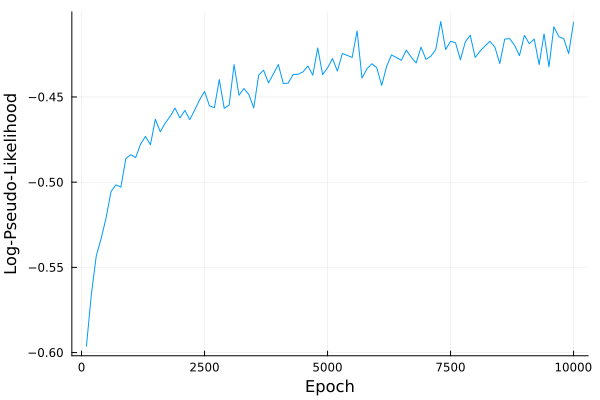

In [318]:
#Build data 
hidden_data1 = zeros(n_hidden1, data_shape[3])
for i in 1:data_shape[3]
    hidden_data1[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm1, data_hits[:,:,i]) 
end

logfile = open("./Log/Stacked2.txt", "w+")


n_hidden2 = 128
data = hidden_data1

rbm2 = center(RBM(Binary((n_hidden1,)), Binary((n_hidden2,)), zeros(n_hidden1, n_hidden2)));
initialize!(rbm2, data);

pcd!(
    rbm2, data; 
    batchsize=256, iters=10000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=hidden_data1[.., rand(1:size(hidden_data1)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked2.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood") 

## Third RBM


[2023-04-22 23:23:37] Info: 100 lpl = -0.6177185712142349, Δt = 0.022242792


[2023-04-22 23:23:38] Info: 200 lpl = -0.5814980427221198, Δt = 0.013561917


[2023-04-22 23:23:39] Info: 300 lpl = -0.5547652058265292, Δt = 0.014881583


[2023-04-22 23:23:40] Info: 400 lpl = -0.5329429420054735, Δt = 0.014762667


[2023-04-22 23:23:40] Info: 500 lpl = -0.5177113029314008, Δt = 0.015247959


[2023-04-22 23:23:41] Info: 600 lpl = -0.5250085535456486, Δt = 0.015864084


[2023-04-22 23:23:42] Info: 700 lpl = -0.4857377929717226, Δt = 0.016022


[2023-04-22 23:23:43] Info: 800 lpl = -0.4869883059305876, Δt = 0.016390834


[2023-04-22 23:23:44] Info: 900 lpl = -0.4743323655672882, Δt = 0.016483


[2023-04-22 23:23:45] Info: 1000 lpl = -0.4797819490873645, Δt = 0.01682725


[2023-04-22 23:23:45] Info: 1100 lpl = -0.4764936479919134, Δt = 0.017040083


[2023-04-22 23:23:46] Info: 1200 lpl = -0.4716562197642486, Δt = 0.017196416


[2023-04-22 23:23:47] Info: 1300 lpl = -0.4732914448357616, Δt = 0.01702125


[2023-04-22 23:23:48] Info: 1400 lpl = -0.47012619087505064, Δt = 0.016959167


[2023-04-22 23:23:49] Info: 1500 lpl = -0.4591092117122227, Δt = 0.01736625


[2023-04-22 23:23:49] Info: 1600 lpl = -0.44841072318685177, Δt = 0.017063125


[2023-04-22 23:23:50] Info: 1700 lpl = -0.4505889069545171, Δt = 0.0173185


[2023-04-22 23:23:51] Info: 1800 lpl = -0.46072204208219913, Δt = 0.017819833


[2023-04-22 23:23:52] Info: 1900 lpl = -0.4558875970982657, Δt = 0.017700375


[2023-04-22 23:23:53] Info: 2000 lpl = -0.45760976751772947, Δt = 0.017624


[2023-04-22 23:23:53] Info: 2100 lpl = -0.43524564877541816, Δt = 0.017966667


[2023-04-22 23:23:54] Info: 2200 lpl = -0.4445579508232201, Δt = 0.017898583


[2023-04-22 23:23:55] Info: 2300 lpl = -0.45174571497253185, Δt = 0.017934167


[2023-04-22 23:23:56] Info: 2400 lpl = -0.4504059873877477, Δt = 0.018165167


[2023-04-22 23:23:57] Info: 2500 lpl = -0.4291866021312623, Δt = 0.01824725


[2023-04-22 23:23:58] Info: 2600 lpl = -0.443443154584796, Δt = 0.0180405


[2023-04-22 23:23:58] Info: 2700 lpl = -0.43171360824661154, Δt = 0.017867


[2023-04-22 23:24:00] Info: 2800 lpl = -0.4402248802584787, Δt = 0.020032458


[2023-04-22 23:24:02] Info: 2900 lpl = -0.4376181779234323, Δt = 0.0189715


[2023-04-22 23:24:03] Info: 3000 lpl = -0.4348365125610539, Δt = 0.018496708


[2023-04-22 23:24:04] Info: 3100 lpl = -0.4250346707580539, Δt = 0.0223045


[2023-04-22 23:24:04] Info: 3200 lpl = -0.4271172903330796, Δt = 0.018023083


[2023-04-22 23:24:05] Info: 3300 lpl = -0.42623124344047614, Δt = 0.018662833


[2023-04-22 23:24:06] Info: 3400 lpl = -0.42412099780344104, Δt = 0.018203792


[2023-04-22 23:24:07] Info: 3500 lpl = -0.4324502534227611, Δt = 0.01876375


[2023-04-22 23:24:08] Info: 3600 lpl = -0.42650433201346366, Δt = 0.01889025


[2023-04-22 23:24:09] Info: 3700 lpl = -0.43263670770933305, Δt = 0.020127166


[2023-04-22 23:24:10] Info: 3800 lpl = -0.42164438891263767, Δt = 0.019816292


[2023-04-22 23:24:11] Info: 3900 lpl = -0.42474617529152936, Δt = 0.0186795


[2023-04-22 23:24:11] Info: 4000 lpl = -0.42915942407928837, Δt = 0.019554083


[2023-04-22 23:24:12] Info: 4100 lpl = -0.425096714190152, Δt = 0.02024575


[2023-04-22 23:24:13] Info: 4200 lpl = -0.4261176913578087, Δt = 0.019475208


[2023-04-22 23:24:14] Info: 4300 lpl = -0.41613911302471124, Δt = 0.019529084


[2023-04-22 23:24:15] Info: 4400 lpl = -0.42371856944035863, Δt = 0.018373875


[2023-04-22 23:24:17] Info: 4500 lpl = -0.42528924807829316, Δt = 0.031182791


[2023-04-22 23:24:18] Info: 4600 lpl = -0.411080450196062, Δt = 0.022231583


[2023-04-22 23:24:20] Info: 4700 lpl = -0.4084577624440829, Δt = 0.035497167


[2023-04-22 23:24:23] Info: 4800 lpl = -0.4015172353045247, Δt = 0.027777292


[2023-04-22 23:24:24] Info: 4900 lpl = -0.41261165708424613, Δt = 0.02797675


[2023-04-22 23:24:25] Info: 5000 lpl = -0.42401757555131686, Δt = 0.020026583


[2023-04-22 23:24:26] Info: 5100 lpl = -0.426367699295605, Δt = 0.019244625


[2023-04-22 23:24:27] Info: 5200 lpl = -0.40958811596089356, Δt = 0.025119958


[2023-04-22 23:24:29] Info: 5300 lpl = -0.4210706035995796, Δt = 0.020796208


[2023-04-22 23:24:30] Info: 5400 lpl = -0.40024160776770107, Δt = 0.01933425


[2023-04-22 23:24:31] Info: 5500 lpl = -0.43194303218792923, Δt = 0.0196


[2023-04-22 23:24:32] Info: 5600 lpl = -0.4168548814635663, Δt = 0.020661041


[2023-04-22 23:24:32] Info: 5700 lpl = -0.422587322501188, Δt = 0.018842542


[2023-04-22 23:24:33] Info: 5800 lpl = -0.42190189763446495, Δt = 0.01818525


[2023-04-22 23:24:34] Info: 5900 lpl = -0.41806909151724425, Δt = 0.018208667


[2023-04-22 23:24:34] Info: 6000 lpl = -0.4182383696650957, Δt = 0.0187855


[2023-04-22 23:24:35] Info: 6100 lpl = -0.4073971144554286, Δt = 0.018264417


[2023-04-22 23:24:36] Info: 6200 lpl = -0.4204094781265505, Δt = 0.01785925


[2023-04-22 23:24:37] Info: 6300 lpl = -0.4123722540836092, Δt = 0.018026542


[2023-04-22 23:24:37] Info: 6400 lpl = -0.4148633779253857, Δt = 0.018028667


[2023-04-22 23:24:38] Info: 6500 lpl = -0.4101758652111549, Δt = 0.028041791


[2023-04-22 23:24:39] Info: 6600 lpl = -0.414896981915409, Δt = 0.028063958


[2023-04-22 23:24:39] Info: 6700 lpl = -0.4180561211156378, Δt = 0.018952792


[2023-04-22 23:24:40] Info: 6800 lpl = -0.4186811430110893, Δt = 0.018983541


[2023-04-22 23:24:41] Info: 6900 lpl = -0.41823158176872843, Δt = 0.018122209


[2023-04-22 23:24:41] Info: 7000 lpl = -0.41858657729668475, Δt = 0.019080458


[2023-04-22 23:24:42] Info: 7100 lpl = -0.41446128320895537, Δt = 0.018669792


[2023-04-22 23:24:43] Info: 7200 lpl = -0.415652250705425, Δt = 0.018900584


[2023-04-22 23:24:43] Info: 7300 lpl = -0.42267476059498393, Δt = 0.019113125


[2023-04-22 23:24:44] Info: 7400 lpl = -0.4107581536657308, Δt = 0.019305292


[2023-04-22 23:24:45] Info: 7500 lpl = -0.4104824629468617, Δt = 0.019224042


[2023-04-22 23:24:45] Info: 7600 lpl = -0.4090578132720096, Δt = 0.018922208


[2023-04-22 23:24:46] Info: 7700 lpl = -0.4135084156842164, Δt = 0.018507791


[2023-04-22 23:24:47] Info: 7800 lpl = -0.39424183863680584, Δt = 0.018917041


[2023-04-22 23:24:48] Info: 7900 lpl = -0.40696190023198087, Δt = 0.019236417


[2023-04-22 23:24:48] Info: 8000 lpl = -0.41008416220750643, Δt = 0.018271667


[2023-04-22 23:24:49] Info: 8100 lpl = -0.4029177861119896, Δt = 0.019684542


[2023-04-22 23:24:50] Info: 8200 lpl = -0.40289945031004726, Δt = 0.018994542


[2023-04-22 23:24:50] Info: 8300 lpl = -0.41908347392040385, Δt = 0.019082958


[2023-04-22 23:24:51] Info: 8400 lpl = -0.39889953222137886, Δt = 0.019070417


[2023-04-22 23:24:52] Info: 8500 lpl = -0.40711121084853535, Δt = 0.019452625


[2023-04-22 23:24:52] Info: 8600 lpl = -0.4048713236280573, Δt = 0.0183915


[2023-04-22 23:24:53] Info: 8700 lpl = -0.4067064644894353, Δt = 0.019191417


[2023-04-22 23:24:54] Info: 8800 lpl = -0.4060327009565354, Δt = 0.019012167


[2023-04-22 23:24:54] Info: 8900 lpl = -0.40478923473459605, Δt = 0.01900375


[2023-04-22 23:24:55] Info: 9000 lpl = -0.39843363429748685, Δt = 0.019168375


[2023-04-22 23:24:56] Info: 9100 lpl = -0.40636786180604334, Δt = 0.01918375


[2023-04-22 23:24:57] Info: 9200 lpl = -0.3954309403270107, Δt = 0.019413375


[2023-04-22 23:24:57] Info: 9300 lpl = -0.3926972065448205, Δt = 0.019095875


[2023-04-22 23:24:58] Info: 9400 lpl = -0.411435008969695, Δt = 0.019187


[2023-04-22 23:24:59] Info: 9500 lpl = -0.40550891970546077, Δt = 0.018558875


[2023-04-22 23:24:59] Info: 9600 lpl = -0.3959867195487725, Δt = 0.018529542


[2023-04-22 23:25:00] Info: 9700 lpl = -0.40653889347365535, Δt = 0.019042916


[2023-04-22 23:25:01] Info: 9800 lpl = -0.40470238052068364, Δt = 0.019197292


[2023-04-22 23:25:01] Info: 9900 lpl = -0.40096632099841983, Δt = 0.019124958


[2023-04-22 23:25:02] Info: 10000 lpl = -0.3980580937585562, Δt = 0.019234833


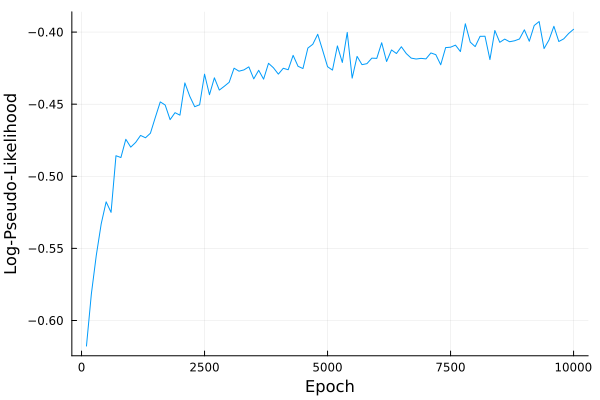

In [319]:
#Build data 
hidden_data2 = zeros(n_hidden2, data_shape[3])
for i in 1:data_shape[3]
    hidden_data2[:,i] = RestrictedBoltzmannMachines.sample_h_from_v(rbm2, hidden_data1[:,i]) 
end

logfile = open("./Log/Stacked3.txt", "w+")


n_hidden3 = 64
data=hidden_data2

rbm3 = center(RBM(Binary((n_hidden2,)), Binary((n_hidden3,)), zeros(n_hidden2, n_hidden3)));
initialize!(rbm3, data);

pcd!(
    rbm3, data; 
    batchsize=256, iters=10000, steps=10, optim=Adam(1f-3), l2l1_weights=1f-3,
    vm=hidden_data2[.., rand(1:size(hidden_data2)[end], 256)], callback
);

close(logfile)

logdata = readdlm("./Log/Stacked3.txt")
iter= logdata[:, 1]
lpl = logdata[:, 2]
plot(iter, lpl, legend=false)
xlabel!("Epoch")
ylabel!("Log-Pseudo-Likelihood")

In [320]:
hidden_data3 = zeros(n_hidden3, data_shape[3])
for i in 1:data_shape[3]
    hidden_data3[:,i]=RestrictedBoltzmannMachines.sample_h_from_v(rbm3, hidden_data2[:,i]) 
end

In [321]:
#Saving Params
wfile = open("./Log/weights_xRelu_stacked1.txt", "w+")
write(wfile, "$(RBM(rbm1).w)")
close(wfile)

wfile = open("./Log/weights_xRelu_stacked2.txt", "w+")
write(wfile, "$(RBM(rbm2).w)")
close(wfile)

wfile = open("./Log/weights_xRelu_stacked3.txt", "w+")
write(wfile, "$(RBM(rbm3).w)")
close(wfile)


# Deeper and Deeper PCA representation

In [322]:
v_data_rot, expl_ratio_v = PCA(reshape(data_hits, (data_shape[1]*data_shape[2], data_shape[3])))
h1_data_rot, expl_ratio_h1 = PCA(hidden_data1)
h2_data_rot, expl_ratio_h2 = PCA(hidden_data2)
h3_data_rot, expl_ratio_h3 = PCA(hidden_data3)

pca_v = [v_data_rot[end-i, :] for i in 0:3]
pca_h1 = [h1_data_rot[end-i, :] for i in 0:3]
pca_h2 = [h2_data_rot[end-i, :] for i in 0:3]
pca_h3 = [h3_data_rot[end-i, :] for i in 0:3]


using DataFrames, StatsPlots
df_h1 = DataFrame(PC1=pca_h1[1], PC2=pca_h1[2], PC3=pca_h1[3], PC4=pca_h1[4], Label=label[:,])
df_h2 = DataFrame(PC1=pca_h2[1], PC2=pca_h2[2], PC3=pca_h2[3], PC4=pca_h2[4], Label=label[:,]) 
df_h3 = DataFrame(PC1=pca_h3[1], PC2=pca_h3[2], PC3=pca_h3[3], PC4=pca_h3[4], Label=label[:,]) 




# exclude "other" from plotting
filter!(row -> row.Label .!= "other", df_v)
filter!(row -> row.Label .!= "other", df_h1)
filter!(row -> row.Label .!= "other", df_h2)
filter!(row -> row.Label .!= "other", df_h3)


Row,PC1,PC2,PC3,PC4,Label
,Float64,Float64,Float64,Float64,Any
1,-0.95641,-0.418116,-0.273509,0.644972,Bacillota
2,-0.966512,-0.265447,-0.512323,0.38977,Bacillota
3,-1.49843,0.487497,-0.734216,1.30666,Bacillota
4,-1.67578,0.655324,0.604119,0.450765,Bacillota
5,-0.512727,-1.57447,-0.654637,0.492487,Bacillota
6,-0.171406,-0.447814,-0.706948,-0.8255,Bacillota
7,-0.0988185,-1.14322,-1.36359,-0.290074,Bacillota
8,-0.933956,0.185432,0.542846,0.775972,Bacillota
9,-0.334717,-1.20748,-0.389851,-0.375632,Bacillota


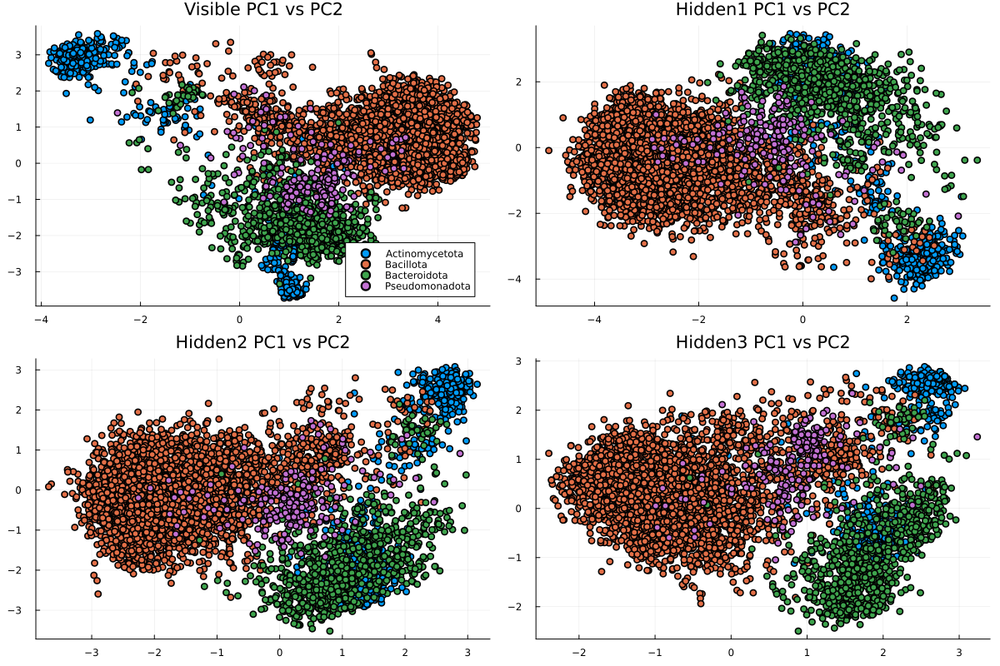

In [333]:
p1 = scatter(df_v.PC1 , df_v.PC2, group=df_v.Label, title="Visible PC1 vs PC2")
p2 = scatter(df_h1.PC1 , df_h1.PC2, group=df_h1.Label, title="Hidden1 PC1 vs PC2", legend=false)
p3 = scatter(df_h2.PC1 , df_h2.PC2, group=df_h2.Label, title="Hidden2 PC1 vs PC2", legend=false)
p4 = scatter(df_h3.PC1 , df_h3.PC2, group=df_h3.Label,title="Hidden3 PC1 vs PC2", legend=false)


plot(p1, p2, p3, p4, layout=(2,2), size=(1200,800))

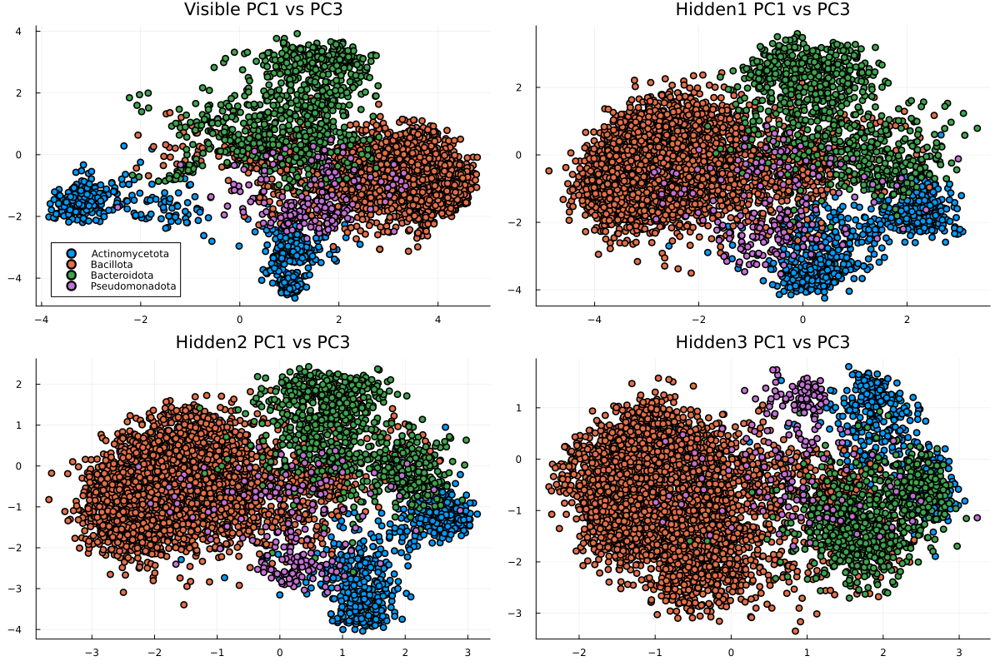

In [334]:
p1 = scatter(df_v.PC1 , df_v.PC3, group=df_v.Label, title="Visible PC1 vs PC3")
p2 = scatter(df_h1.PC1 , df_h1.PC3, group=df_h1.Label, title="Hidden1 PC1 vs PC3", legend=false)
p3 = scatter(df_h2.PC1 , df_h2.PC3, group=df_h2.Label, title="Hidden2 PC1 vs PC3", legend=false)
p4 = scatter(df_h3.PC1 , df_h3.PC3, group=df_h3.Label,title="Hidden3 PC1 vs PC3", legend=false)


plot(p1, p2, p3, p4, layout=(2,2), size=(1200,800))

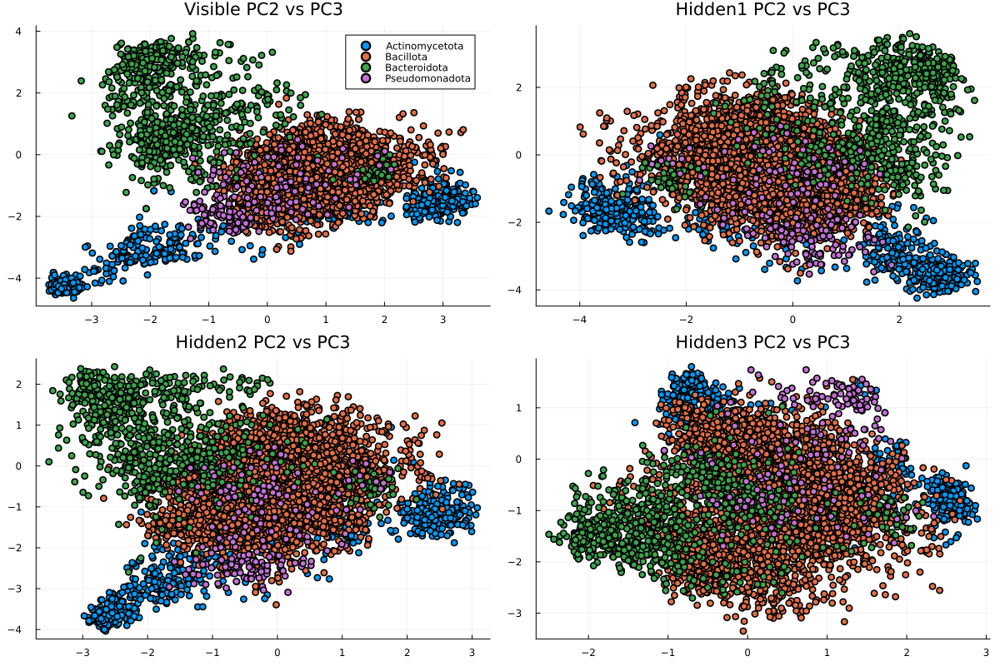

In [335]:
p1 = scatter(df_v.PC2 , df_v.PC3, group=df_v.Label, title="Visible PC2 vs PC3")
p2 = scatter(df_h1.PC2 , df_h1.PC3, group=df_h1.Label, title="Hidden1 PC2 vs PC3", legend=false)
p3 = scatter(df_h2.PC2 , df_h2.PC3, group=df_h2.Label, title="Hidden2 PC2 vs PC3", legend=false)
p4 = scatter(df_h3.PC2 , df_h3.PC3, group=df_h3.Label,title="Hidden3 PC2 vs PC3", legend=false)


plot(p1, p2, p3, p4, layout=(2,2), size=(1200,800))